In [1]:
import pandas as pd
import numpy as np
import analyze as an
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from PIL import Image
import requests
import cv2
import io
import category_encoders as ce


%matplotlib inline
from matplotlib import pyplot as plt

# Enable module reloading
%load_ext autoreload
%autoreload 2

In first step the dataframes are loaded for every group (train, test, valid):
- image_ids - contains informations about images -> ID, original_url, size etc.
- labels - defined labels for images. Every row contains one label with image ID and confidence, whether the label is valid (range between 0 and 1)
- relationships - contains triplets (for example 'man' + 'in' + 'car') with image id and bounding boxes for those two objects

In [2]:
tr_ids, tr_labels, tr_relationships = an.load_data("./train/image_ids.csv", 
                                                            "./train/labels.csv", 
                                                            "./train/relationships.csv")
te_ids, te_labels, te_relationships = an.load_data("./test/image_ids.csv", 
                                                         "./test/labels.csv", 
                                                         "./test/relationships.csv")
val_ids, val_labels, val_relationships = an.load_data("./valid/image_ids.csv", 
                                                         "./valid/labels.csv", 
                                                         "./valid/relationships.csv")

In [3]:
tr_ids.head(3)

,ImageID,Subset,OriginalURL,OriginalLandingURL,License,AuthorProfileURL,Author,Title,OriginalSize,OriginalMD5,Thumbnail300KURL,Rotation
0,4fa8054781a4c382,train,https://farm3.staticflickr.com/5310/5898076654...,https://www.flickr.com/photos/michael-beat/589...,https://creativecommons.org/licenses/by/2.0/,https://www.flickr.com/people/michael-beat/,Michael Beat,...die FNF-Kerze,4405052,KFukvivpCM5QXl5SqKe41g==,https://c1.staticflickr.com/6/5310/5898076654_...,0.0
1,b37f763ae67d0888,train,https://c1.staticflickr.com/1/67/197493648_628...,https://www.flickr.com/photos/drstarbuck/19749...,https://creativecommons.org/licenses/by/2.0/,https://www.flickr.com/people/drstarbuck/,Karen,Three boys on a hill,494555,9IzEn38GRNsVpATuv7gzEA==,https://c3.staticflickr.com/1/67/197493648_628...,0.0
2,7e8584b0f487cb9e,train,https://c7.staticflickr.com/8/7056/7143870979_...,https://www.flickr.com/photos/circasassy/71438...,https://creativecommons.org/licenses/by/2.0/,https://www.flickr.com/people/circasassy/,CircaSassy,A Christmas carol and The cricket on the heart...,2371584,3hQwu0iSzY1VIoXiwp0/Mg==,https://c7.staticflickr.com/8/7056/7143870979_...,0.0


In [4]:
tr_labels.head(3)

,ImageID,Source,LabelName,Confidence
0,000002b66c9c498e,verification,/m/014j1m,0
1,000002b66c9c498e,verification,/m/014sv8,1
2,000002b66c9c498e,verification,/m/01599,0


In [5]:
tr_relationships.head(3)

,ImageID,LabelName1,LabelName2,XMin1,XMax1,YMin1,YMax1,XMin2,XMax2,YMin2,YMax2,RelationshipLabel
0,fe58ec1b06db2bb7,/m/04bcr3,/m/083vt,0.0050,0.033125,0.580000,0.627778,0.0050,0.033125,0.580000,0.627778,is
1,82d16a22f703df5c,/m/04dr76w,/m/02gy9n,0.6120,0.735000,0.418919,0.950450,0.6120,0.735000,0.418919,0.950450,is
2,b54d41beabcfd900,/m/01mzpv,/m/083vt,0.3725,0.399375,0.706413,0.778557,0.3725,0.399375,0.706413,0.778557,is


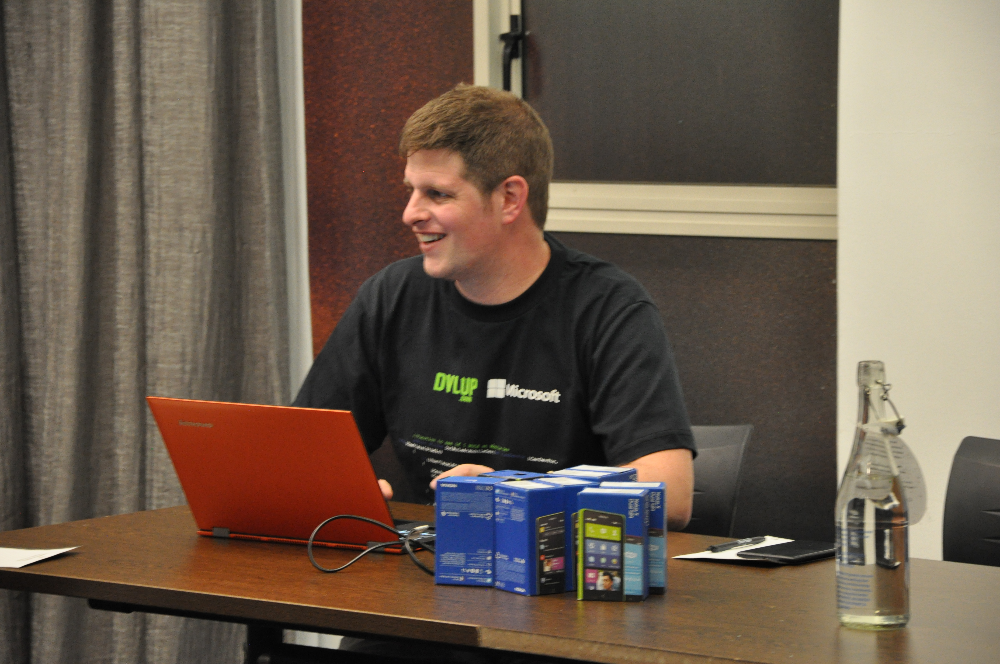

In [6]:
url = tr_ids[tr_ids['ImageID'] == '487e3f4413229d30']['OriginalURL'].iloc[0]
an.show_image(url)

## Labels
We collect the first basic informations about datasets: number of images, number of label classes, top 10 most frequent labels, we analyze mainly the train data, because we need to define a subset big enough for training with lower number of label types

In [7]:
top_overall, top_one = an.basic_analysis(tr_ids, tr_labels)

number of images: 1743042
number of label classes: 601
average number of labels per image: 5.161548029250012
top 10 classes: 
            Image count  Class name
LabelName                          
/m/01g317        839436      Person
/m/09j2d         675650    Clothing
/m/04yx4         472414         Man
/m/05s2s         436288       Plant
/m/07j7r         423757        Tree
/m/0dzct         387233  Human face
/m/03bt1vf       374226       Woman
/m/05r655        285212        Girl
/m/07yv9         268935     Vehicle
/m/0cgh4         257362    Building
sum             4420513         sum

number of images with 1 label: 122870
number of label classes: 590
average number of labels per image: 1.0
top 10 classes: 
           Image count Class name
LabelName                        
/m/07j7r         19208       Tree
/m/0cgh4         16011   Building
/m/01g317        15123     Person
/m/02wbm          5440       Food
/m/05s2s          4964      Plant
/m/09j2d          1628   Clothing
/m/07yv9 

there are 1743042 images in train dataset with average 5,16 labels/image. In this case we were working with labels which are having confidence=0. In next step we remove them, for training we need only the validated labels

In [8]:
tr_labels = tr_labels[tr_labels['Confidence']==1]
top_overall, top_one = an.basic_analysis(tr_ids, tr_labels)

number of images: 1743042
number of label classes: 601
average number of labels per image: 3.799230884855328
top 10 classes: 
            Image count    Class name
LabelName                            
/m/01g317        807090        Person
/m/09j2d         610840      Clothing
/m/04yx4         378360           Man
/m/0dzct         331942    Human face
/m/07j7r         315026          Tree
/m/05s2s         266978         Plant
/m/03bt1vf       265791         Woman
/m/07yv9         228351       Vehicle
/m/0cgh4         183125      Building
/m/01prls        165525  Land vehicle
sum             3553028           sum

number of images with 1 label: 304075
number of label classes: 597
average number of labels per image: 1.0
top 10 classes: 
           Image count Class name
LabelName                        
/m/07j7r         52405       Tree
/m/01g317        30793     Person
/m/0cgh4         28587   Building
/m/05s2s         24950      Plant
/m/02wbm         11355       Food
/m/0c9ph5        

In this case the average number of labels/image decreased by cca 1,5

the top 10 labels according to number of images isn't changing too much.

We are assuming, that images with only one label also contains less objects, so they may be better for training.

# Relationships

In [9]:
len(set(tr_relationships["LabelName1"].values).union(set(tr_relationships["LabelName2"].values)))

62

There are 62 unique labels, which are having relationships with other objects on images.

We are searching for the top 10 mostfrequent label in this case as well

In [10]:
top_labels1 = tr_relationships.groupby('LabelName1').count().sort_values('ImageID', ascending=False).head(10)['ImageID'].to_frame()

In [11]:
top_labels2 = tr_relationships.groupby('LabelName2').count().sort_values('ImageID', ascending=False).head(10)['ImageID'].to_frame()

In [12]:
for i in range(10):
    if(top_labels2.index[i] in top_labels1.index):
        top_labels1.loc[top_labels2.index[i]] += top_labels2.iloc[i].values[0]
    else:
        top_labels1 = top_labels1.append(top_labels2.iloc[i])

In [13]:
top = top_labels1.head(10).index.values
an.decode_class_names(top)

['Chair',
 'Man',
 'Table',
 'Woman',
 'Bottle',
 'Guitar',
 'Girl',
 'Desk',
 'Bench',
 'Handbag']

In [14]:
tr_relationships

,ImageID,LabelName1,LabelName2,XMin1,XMax1,YMin1,YMax1,XMin2,XMax2,YMin2,YMax2,RelationshipLabel
0,fe58ec1b06db2bb7,/m/04bcr3,/m/083vt,0.005000,0.033125,0.580000,0.627778,0.005000,0.033125,0.580000,0.627778,is
1,82d16a22f703df5c,/m/04dr76w,/m/02gy9n,0.612000,0.735000,0.418919,0.950450,0.612000,0.735000,0.418919,0.950450,is
2,b54d41beabcfd900,/m/01mzpv,/m/083vt,0.372500,0.399375,0.706413,0.778557,0.372500,0.399375,0.706413,0.778557,is
3,4b6a08cc110d7275,/m/01mzpv,/m/01y9k5,0.171250,0.255625,0.557500,0.749167,0.207500,0.683125,0.611667,0.999167,at
4,0144cfbb726f4c72,/m/01mzpv,/m/04bcr3,0.855000,0.950000,0.561667,0.609167,0.828750,0.999375,0.568333,0.673333,at
...,...,...,...,...,...,...,...,...,...,...,...,...
374763,d44069704bc69b9e,/m/04yx4,/m/01y9k5,0.576250,0.818125,0.182500,0.791667,0.003125,0.788750,0.667500,0.993333,at
374764,d32cf9a718b3a089,/m/07y_7,/m/083vt,0.440625,0.551875,0.152500,0.840833,0.440625,0.551875,0.152500,0.840833,is
374765,82748ba0065538ef,/m/01mzpv,/m/04bcr3,0.015000,0.241875,0.668862,0.999059,0.248125,0.778750,0.698024,0.999059,at
374766,1d8afa0f6b9bcd61,/m/01mzpv,/m/083vt,0.978750,0.999375,0.482176,0.656660,0.978750,0.999375,0.482176,0.656660,is


In [15]:
tr_relationships[(tr_relationships['LabelName1'].isin(top)) & (tr_relationships['LabelName2'].isin(top))]['RelationshipLabel'].nunique()

5

Now we are searching only for images, where both labels are from top 10.

In [16]:
ids = tr_relationships[(tr_relationships['LabelName1'].isin(top)) & (tr_relationships['LabelName2'].isin(top))]['ImageID']

In [17]:
ids.shape[0]

135832

In [18]:
ids.nunique()

34816

In train set we are having 34816 images and 135832 triplets with boundig boxes. We are going to use this images for training our model.

In [19]:
image_ids = ids.unique()

Example of an image with labeled triplets:

4           Chair at Table
25482      Table is Wooden
27357      Table is Wooden
30111       Chair at Table
37650      Table is Wooden
                ...       
322067    Chair is Plastic
323953    Chair is Plastic
347139    Chair is Plastic
354394     Table is Wooden
365950      Chair at Table
Name: RelationshipLabel, Length: 77, dtype: object


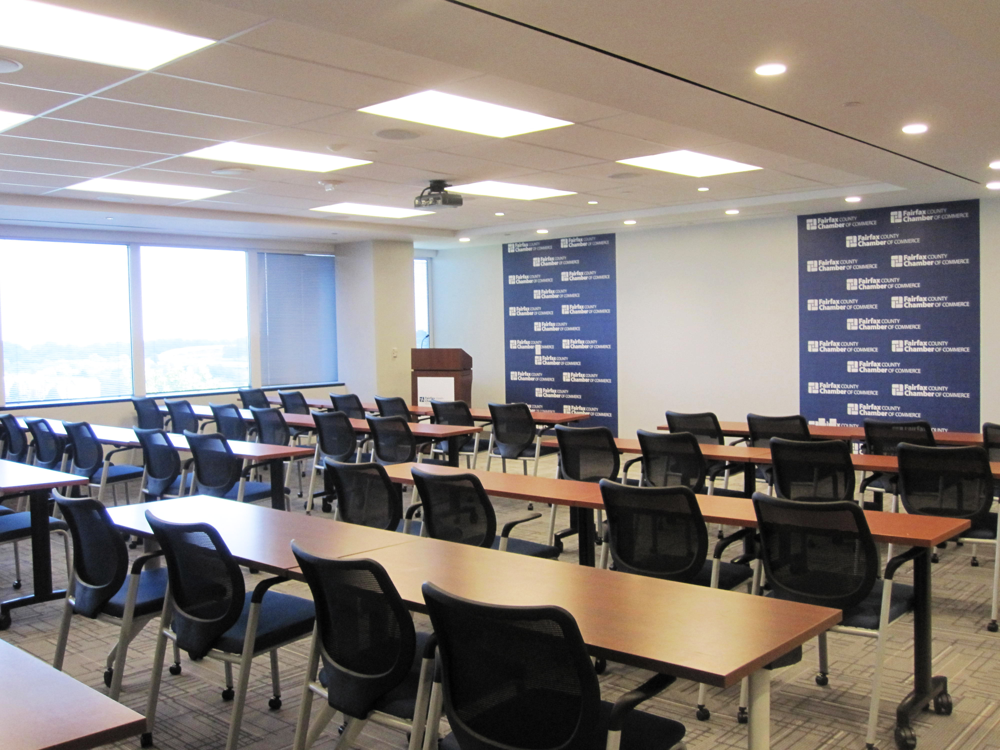

In [20]:
ind = 1
print(an.get_image_relationships(tr_relationships, image_ids[ind]))
url = tr_ids[tr_ids['ImageID'] == image_ids[ind]]['OriginalURL'].iloc[0]
an.show_image(url)

We select the url adresses of desired images

In [21]:
urls = tr_ids.loc[tr_ids['ImageID'].isin(image_ids)]['OriginalURL'].values

In [22]:
len(urls)

34816

# Preprocessing
We create a generator object for image preprocessing

In [324]:
g = an.image_array_generator(urls, tr_relationships, tr_ids, batch_size=50, resize=True, size=(20,20), normalize=True)

In [ ]:
bb = next(g)

https://farm5.staticflickr.com/22/28170126_b4cfea2ddb_o.jpg
https://farm7.staticflickr.com/5171/5507891238_deeeb984d1_o.jpg
https://c2.staticflickr.com/1/146/427360857_65efa5a3d7_o.jpg
https://farm4.staticflickr.com/6213/6317042640_dc84fb436c_o.jpg
https://farm6.staticflickr.com/3798/10446639605_0fb62317f0_o.jpg
https://c7.staticflickr.com/8/7011/6662131799_eb7aaa68f9_o.jpg
https://c8.staticflickr.com/3/2876/9097392157_371d5f2fde_o.jpg
https://c4.staticflickr.com/1/279/18842007290_5dfab4868c_o.jpg


In [322]:
len(bb)

5

Structure of the response: \[np.array(width, height,3), np.array(3), np.array(8)\] -> \[image, encoded_labels, bounding_box_coordinates\]

In [323]:
bb[0]

[array([[[ 0.41732287,  0.5826771 ,  0.79527557],
         [ 0.48818898,  0.6377952 ,  0.85039365],
         [ 0.52755904,  0.6850394 ,  0.89763784],
         ...,
         [ 0.1889764 ,  0.03937006,  0.14173234],
         [ 0.7401575 ,  0.88976383,  0.91338587],
         [ 0.7480315 ,  0.90551186,  0.91338587]],
 
        [[ 0.41732287,  0.5826771 ,  0.79527557],
         [ 0.496063  ,  0.64566934,  0.85826766],
         [ 0.53543305,  0.6850394 ,  0.89763784],
         ...,
         [ 0.15748036,  0.        ,  0.11811018],
         [ 0.7637795 ,  0.9212599 ,  0.9212599 ],
         [ 0.7637795 ,  0.9212599 ,  0.90551186]],
 
        [[ 0.4251969 ,  0.59055114,  0.79527557],
         [ 0.48031497,  0.6299212 ,  0.84251964],
         [ 0.52755904,  0.6850394 ,  0.89763784],
         ...,
         [ 0.19685042,  0.03937006,  0.11811018],
         [ 0.77952754,  0.9212599 ,  0.91338587],
         [ 0.77952754,  0.9212599 ,  0.91338587]],
 
        ...,
 
        [[-0.511811  , -0.14960629